# **Task 5-1**
**Task 5-1:** Try and compare different Object Detection and Image Segmentation approached: YOLO (try different versions), SSD, RetinaNet, FasterRCNN, MaskRCNN, U-Net, Yolact, etc. Prepare a set of test images (e.g. 10), put results and performance comparison into report. Please, do not forget to mention corresponding implementation for the model you have been used (links, etc.)

In [ ]:
from google.colab import drive
drive.mount('/content/drive') #/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images

Mounted at /content/drive


In [ ]:
!pip install ultralytics -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.5/719.5 kB 11.5 MB/s eta 0:00:00


##**YOLOv8 Instance Segmentation**

100%|██████████| 52.4M/52.4M [00:00<00:00, 266MB/s]



image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9085.JPG: 448x640 12 persons, 4 wine glasss, 1 cup, 1175.0ms
Speed: 15.1ms preprocess, 1175.0ms inference, 62.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict
1 label saved to runs/segment/predict/labels


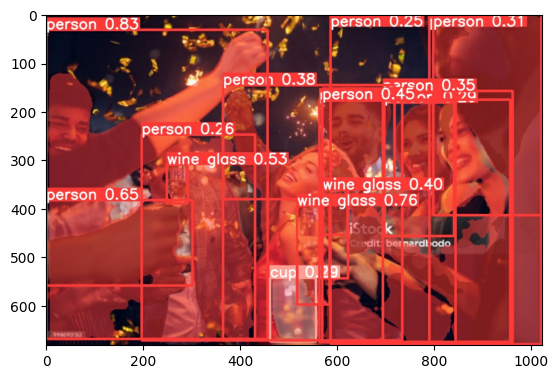


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9086.JPG: 512x640 1 surfboard, 1114.8ms
Speed: 1.8ms preprocess, 1114.8ms inference, 2.8ms postprocess per image at shape (1, 3, 512, 640)
Results saved to runs/segment/predict
2 labels saved to runs/segment/predict/labels


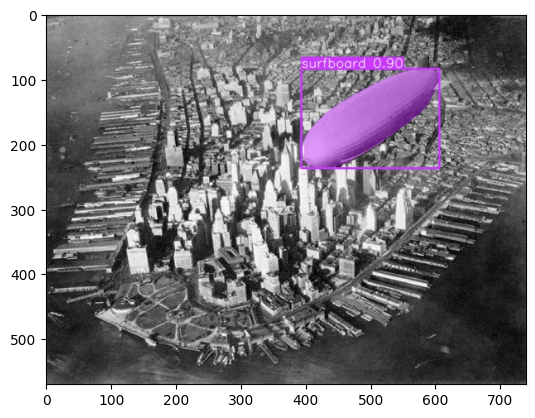


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG: 448x640 11 persons, 1 dog, 1066.6ms
Speed: 2.8ms preprocess, 1066.6ms inference, 18.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict
3 labels saved to runs/segment/predict/labels


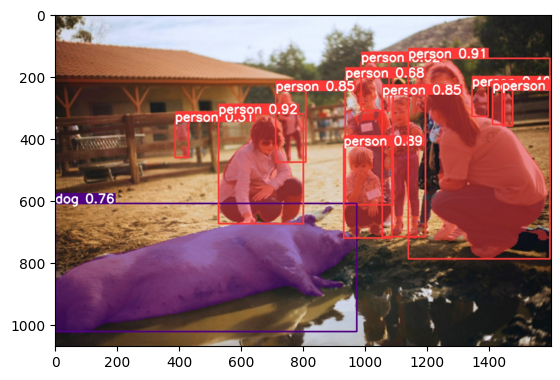


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9088.JPG: 384x640 5 persons, 2 cars, 1 fire hydrant, 2 umbrellas, 1 handbag, 829.4ms
Speed: 1.5ms preprocess, 829.4ms inference, 14.7ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict
4 labels saved to runs/segment/predict/labels


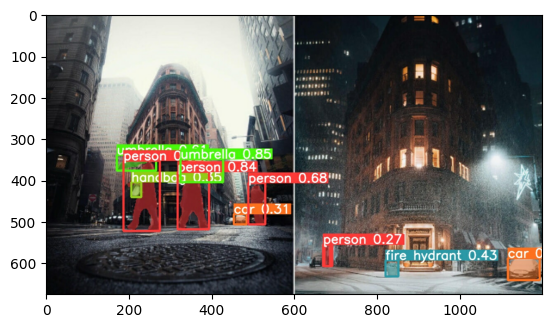


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9090.JPG: 640x512 (no detections), 1213.9ms
Speed: 2.4ms preprocess, 1213.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Results saved to runs/segment/predict
4 labels saved to runs/segment/predict/labels


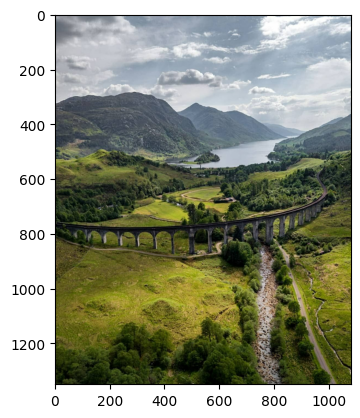


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9091.jpg.png: 640x608 11 persons, 1527.4ms
Speed: 2.5ms preprocess, 1527.4ms inference, 38.5ms postprocess per image at shape (1, 3, 640, 608)
Results saved to runs/segment/predict
5 labels saved to runs/segment/predict/labels


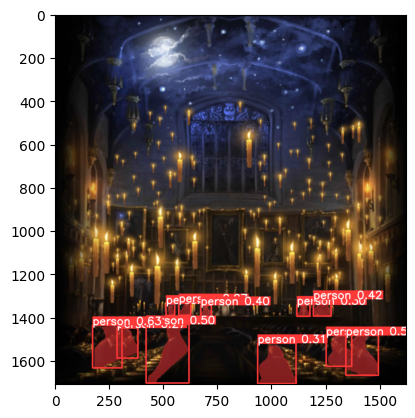


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9092.JPG: 640x448 7 persons, 1043.6ms
Speed: 2.3ms preprocess, 1043.6ms inference, 13.7ms postprocess per image at shape (1, 3, 640, 448)
Results saved to runs/segment/predict
6 labels saved to runs/segment/predict/labels


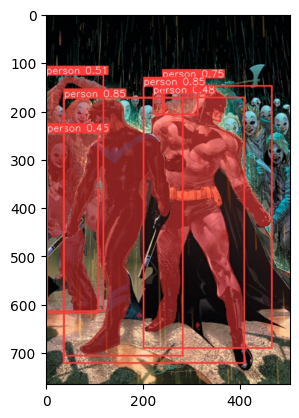


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9093.JPG: 640x448 (no detections), 993.5ms
Speed: 1.7ms preprocess, 993.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 448)
Results saved to runs/segment/predict
6 labels saved to runs/segment/predict/labels


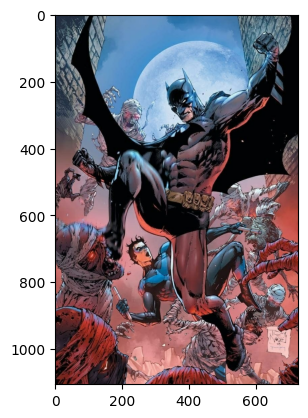


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9094.JPG: 640x416 2 persons, 887.8ms
Speed: 1.9ms preprocess, 887.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 416)
Results saved to runs/segment/predict
7 labels saved to runs/segment/predict/labels


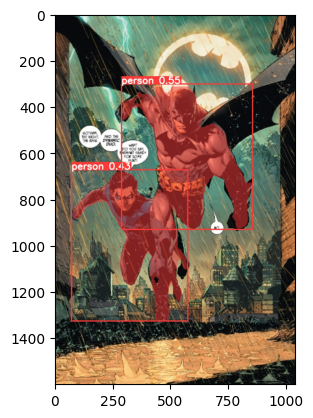


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9095.JPG: 480x640 (no detections), 1325.4ms
Speed: 3.4ms preprocess, 1325.4ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/segment/predict
7 labels saved to runs/segment/predict/labels


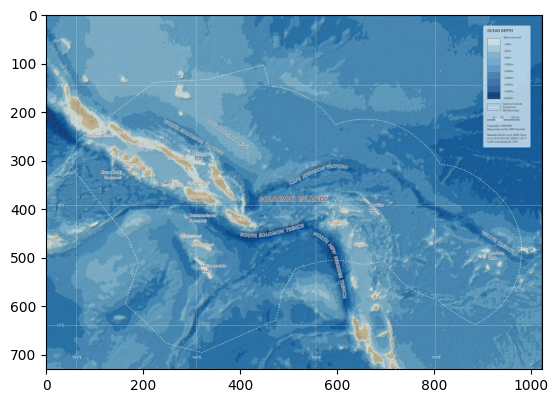

In [ ]:
import os
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import tensorflow as tf

# Load the model
model = YOLO("yolov8m-seg.pt")

# Define a function to load an image
def load_image(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = img[tf.newaxis, :]
    return img

# Path to the directory containing images
folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Get a list of all files in the directory
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Perform prediction
    predict = model.predict(image_path, save=True, save_txt=True)

    # Load the segmented image
    segmented_image = np.squeeze(load_image("/content/runs/segment/predict/" + image_file))

    # Display the segmented image
    plt.imshow(segmented_image)
    plt.show()


### **Step by step try for one image at a time**

In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import tensorflow as tf

In [ ]:
def load_image(img_path):
  img = tf.io.read_file(img_path)
  img = tf.image.decode_image(img, channels = 3)
  img = tf.image.convert_image_dtype(img, tf.float32)
  img = img[tf.newaxis, :]
  return img

In [ ]:
model = YOLO("yolov8m-seg.pt")

100%|██████████| 52.4M/52.4M [00:00<00:00, 72.7MB/s]


In [ ]:
predict = model.predict("/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG",
                        save = True, save_txt = True)


image 1/1 /content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG: 448x640 11 persons, 1 dog, 1694.3ms
Speed: 19.6ms preprocess, 1694.3ms inference, 70.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict
1 label saved to runs/segment/predict/labels


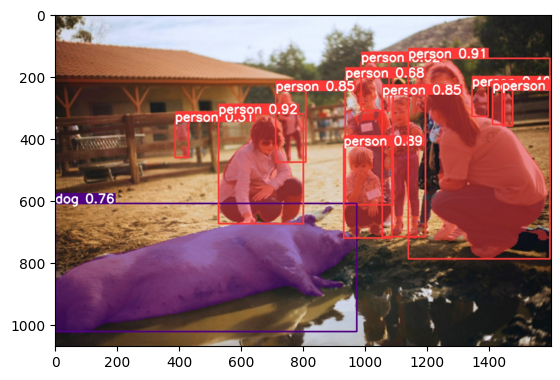

In [ ]:
plt.imshow(np.squeeze(load_image("/content/runs/segment/predict/IMG_9087.JPG")))
plt.show()

In [ ]:
!git clone https://github.com/noorkhokhar99/yolov7-instance-segmentation.git
!cd yolov7-segmentation
!pip install --upgrade pip
!pip install -r requirements.txt

Cloning into 'yolov7-instance-segmentation'...
remote: Enumerating objects: 102, done.
remote: Counting objects: 100% (16/16), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 102 (delta 7), reused 0 (delta 0), pack-reused 86
Receiving objects: 100% (102/102), 4.52 MiB | 9.68 MiB/s, done.
Resolving deltas: 100% (27/27), done.
/bin/bash: line 1: cd: yolov7-segmentation: No such file or directory
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 13.0 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'


In [ ]:
# !pip install sort_count
# !pip install filterpy
# from sort_count import *
# from filterpy.kalman import KalmanFilter

from models.common import DetectMultiBackend
from utils.dataloaders import exif_transpose, letterbox
from utils.augmentations import *
from utils.general import LOGGER, check_version, colorstr, resample_segments, segment2box
from utils import TryExcept

#for segmentation with detection
!python /content/yolov7-instance-segmentation/segment/predict.py --weights /content/yolov7-seg.pt --source "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG"

#for segmentation with detection + Tracking
!python /content/yolov7-instance-segmentation/segment/predict.py --weights /content/yolov7-seg.pt --source "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG" --trk

ModuleNotFoundError: No module named 'models'

## **Faster RCNN Object Detection**

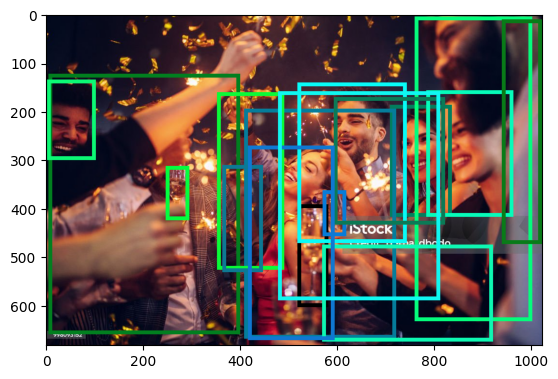

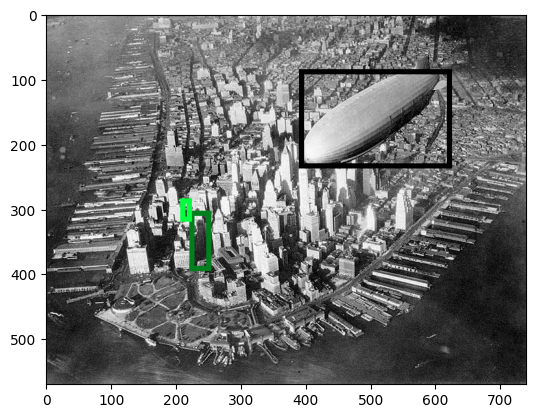

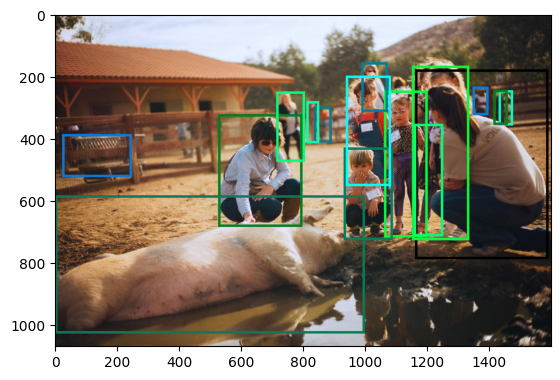

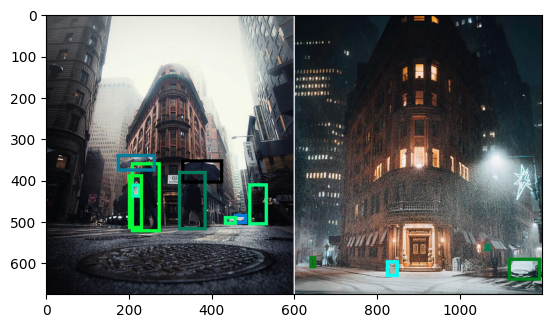

/usr/local/lib/python3.10/dist-packages/torchvision/utils.py:209: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


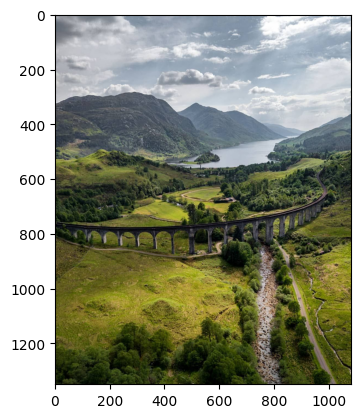

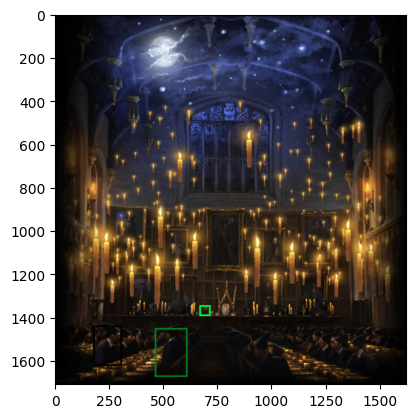

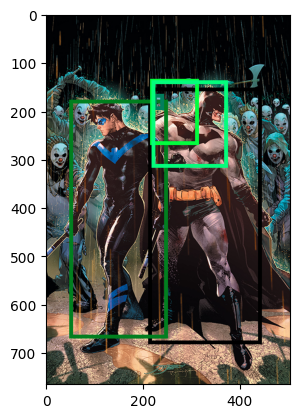

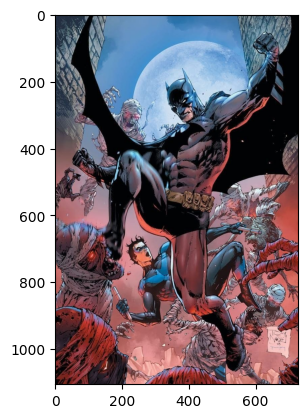

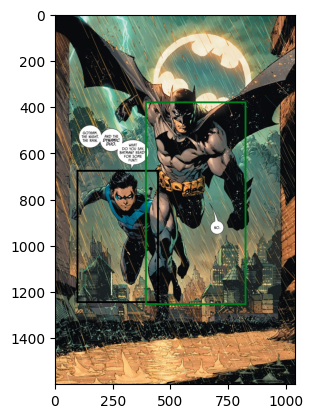

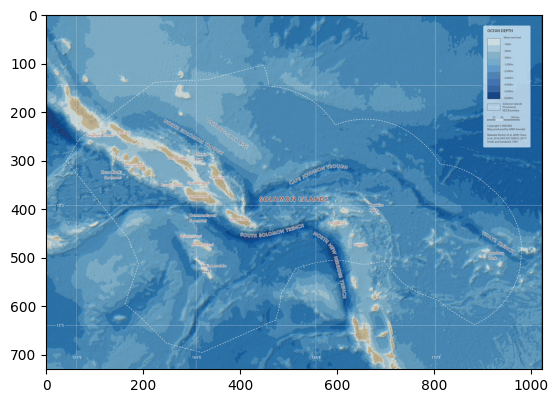

In [ ]:
import os
import torch
from torchvision import models, transforms
from torchvision.utils import draw_bounding_boxes
from PIL import Image
import matplotlib.pyplot as plt

# Load the model
model = models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define a function to load and transform an image
transform = transforms.Compose([
    transforms.ToTensor()
])

def load_image(img_path):
    img = Image.open(img_path)
    img = transform(img)
    return img

# Path to the directory containing images
folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Get a list of all files in the directory
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Load and transform the image
    img = load_image(image_path)
    batched = img.unsqueeze(0)

    # Perform object detection
    with torch.no_grad():
        out = model(batched)

    # Filter out bounding boxes with scores below the threshold
    score_threshold = 0.7
    boxes = out[0]['boxes'][out[0]['scores'] > score_threshold]

    # Convert the image tensor to uint8
    img_uint8 = (img * 255).byte()

    # Draw bounding boxes on the image
    bounding_boxes_img = draw_bounding_boxes(img_uint8, boxes, width=8)

    # Display the image with bounding boxes
    plt.imshow(bounding_boxes_img.permute(1, 2, 0))
    plt.show()


### **Step by step try for one image at a time****

In [ ]:
import torch
import torchvision
from torchvision import models
from torchvision.utils import draw_bounding_boxes
from torchvision import transforms as T
from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
model = models.detection.retinanet_resnet50_fpn(pretrained = True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=RetinaNet_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=RetinaNet_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:01<00:00, 111MB/s]


In [ ]:
model = models.detection.fasterrcnn_resnet50_fpn(pretrained = True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 110MB/s]


In [ ]:
tf_ = T.ToTensor()

In [ ]:
img = Image.open("/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG")
transformed = tf_(img)
batched = transformed.unsqueeze(0)
int_img = torch.tensor(transformed*255, dtype = torch.uint8)

<ipython-input-8-ed617e19a2ea>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  int_img = torch.tensor(transformed*255, dtype = torch.uint8)


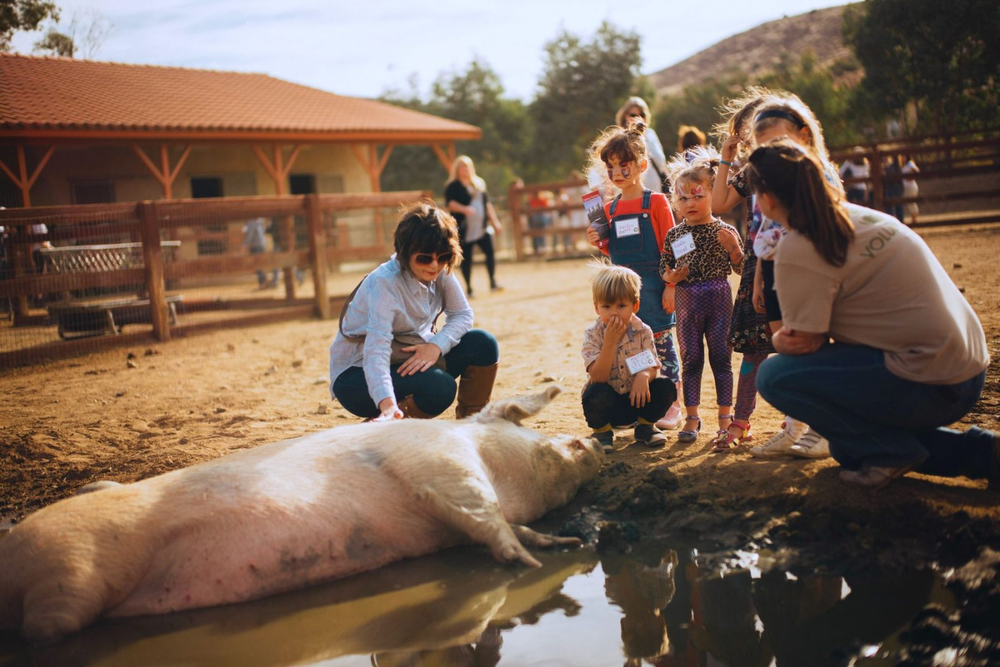

In [ ]:
img

In [ ]:
model = model.eval()
with torch.no_grad():
  out = model(batched)

In [ ]:
score_threshold = .7
first_out = out[0]

In [ ]:
bounding_boxes_img = draw_bounding_boxes(int_img, first_out['boxes'][first_out['scores'] > score_threshold], width=8)

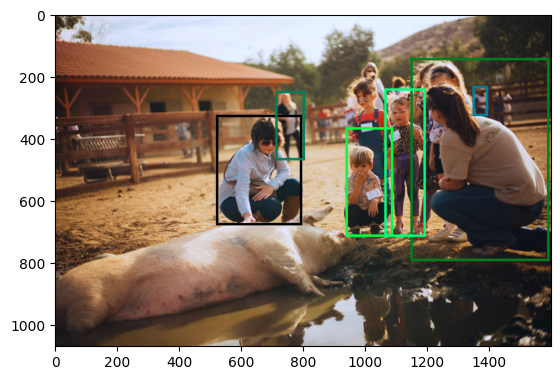

In [ ]:
plt.imshow(bounding_boxes_img.permute(1,2,0))

## **RetinaNet Object Detection**

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=RetinaNet_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=RetinaNet_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:00<00:00, 245MB/s]


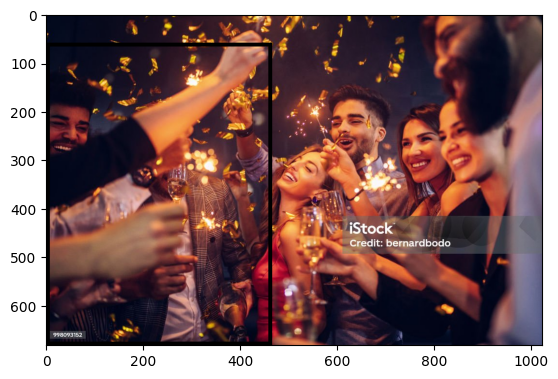

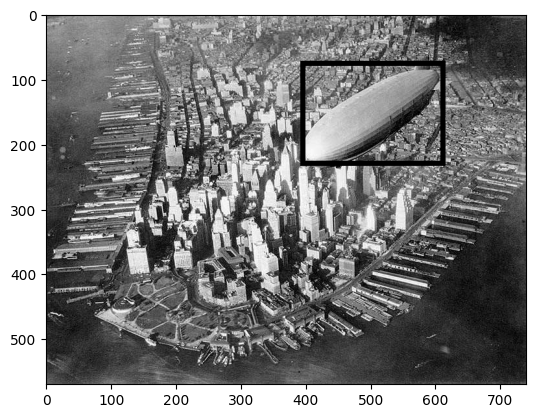

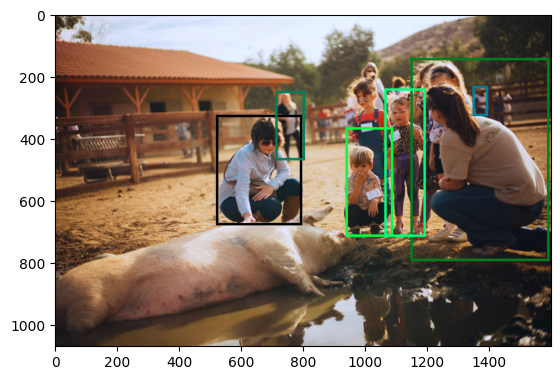

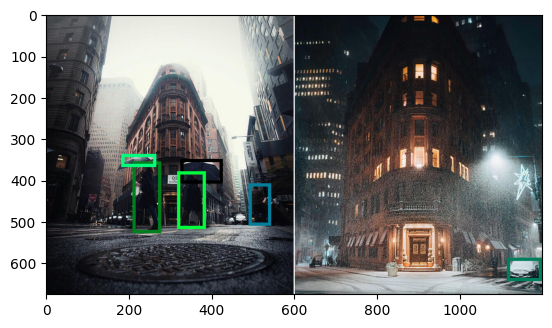

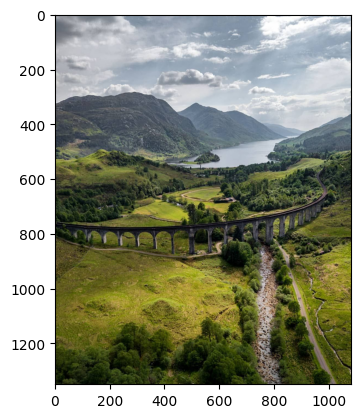

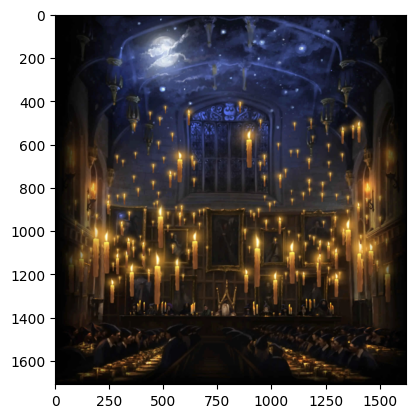

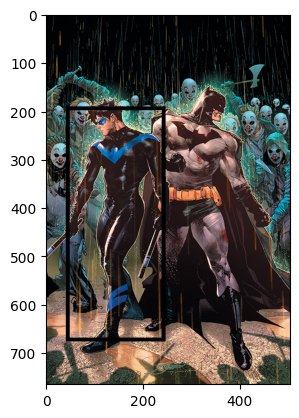

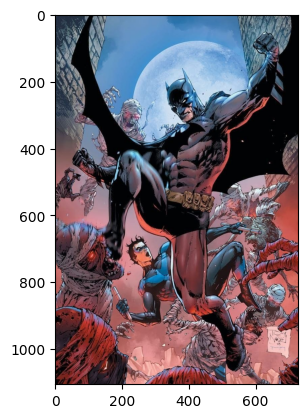

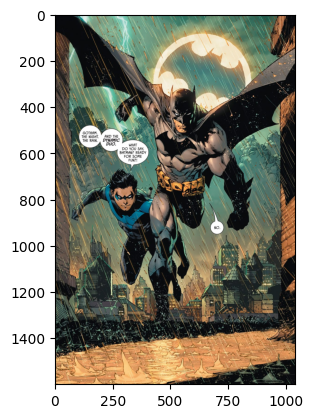

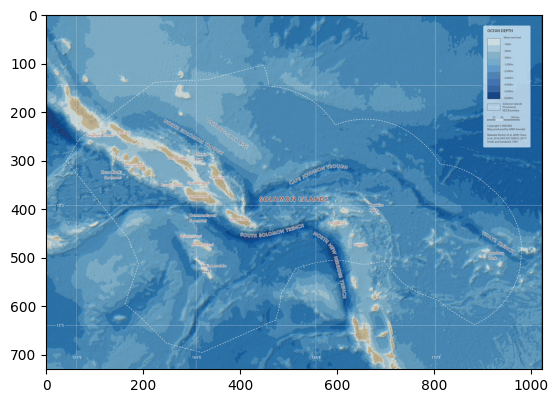

In [ ]:
import os
import torch
from torchvision import models, transforms
from torchvision.utils import draw_bounding_boxes
from PIL import Image
import matplotlib.pyplot as plt

# Load the model
model = models.detection.retinanet_resnet50_fpn(pretrained=True)
model.eval()

# Define a function to load and transform an image
transform = transforms.Compose([
    transforms.ToTensor()
])

def load_image(img_path):
    img = Image.open(img_path)
    img = transform(img)
    return img

# Path to the directory containing images
folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Get a list of all files in the directory
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Load and transform the image
    img = load_image(image_path)
    batched = img.unsqueeze(0)

    # Perform object detection
    with torch.no_grad():
        out = model(batched)

    # Filter out bounding boxes with scores below the threshold
    score_threshold = 0.7
    boxes = out[0]['boxes'][out[0]['scores'] > score_threshold]

    # Convert the image tensor to uint8
    img_uint8 = (img * 255).byte()

    # Draw bounding boxes on the image
    bounding_boxes_img = draw_bounding_boxes(img_uint8, boxes, width=8)

    # Display the image with bounding boxes
    plt.imshow(bounding_boxes_img.permute(1, 2, 0))
    plt.show()

## **Detectron2 (Mask_RCNN) Instance Segmentation**
**Tutorial:** https://youtu.be/e8LPflX0nwQ?si=6azoVDVoV_8sbPqd

Only works with T4 GPU because of the lack of NVIDIA in CPU mode

In [ ]:
import os
import cv2
from datetime import datetime
from google.colab.patches import cv2_imshow
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer

# Path to the directory containing images
folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Define function to process each image
def process_image(image_path, predictor):
    # Read the image
    image = cv2.imread(image_path)

    # Perform prediction
    outputs = predictor(image)

    # Get predicted classes and boxes
    pred_classes = outputs["instances"].pred_classes
    pred_boxes = outputs["instances"].pred_boxes

    # Visualize predictions
    visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Display the image with predictions
    cv2_imshow(out.get_image()[:, :, ::-1])

# Initialize Detectron2 configuration
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)

# Get a list of all files in the directory
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    process_image(image_path, predictor)

### **Step by step try for one image at a time**

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-hyq72yzf
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-hyq72yzf
  Resolved https://github.com/facebookresearch/detectron2.git to commit f3a463104ad99e55b87422b5753ea34723ee272e
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 927.4 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 13.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6120514 sha256=2282a9d7f4e7e438fa7b175b043

In [ ]:
import torch, detectron2

In [ ]:
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

from detectron2 import model_zoo
from detectron2.config import get_cfg

from detectron2.engine import DefaultPredictor

from detectron2.engine import DefaultTrainer

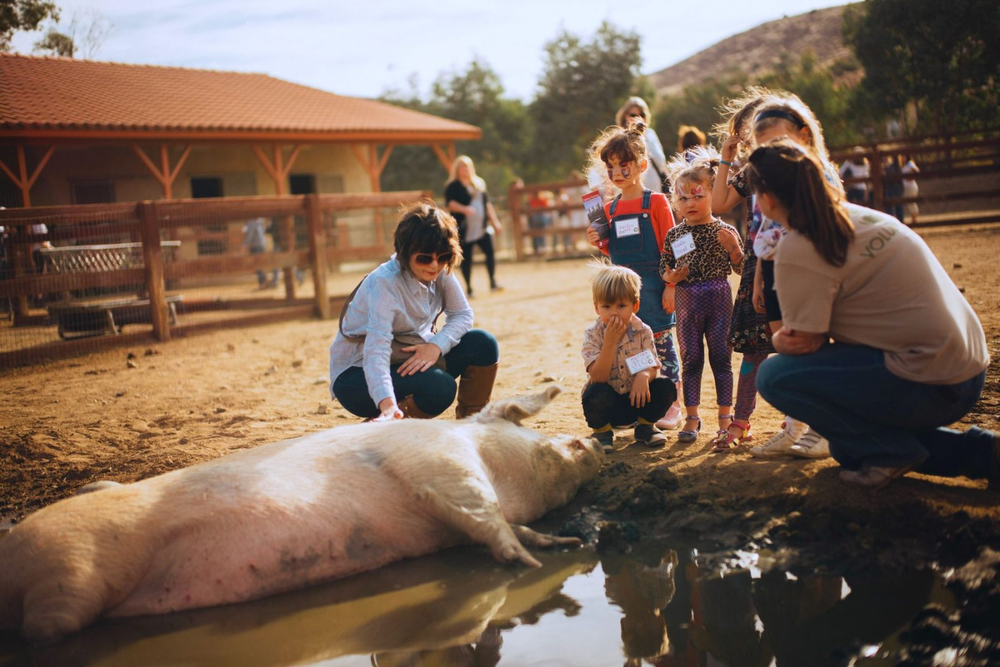

In [ ]:
image = cv2.imread("/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/IMG_9087.JPG")
cv2_imshow(image)

In [ ]:
!pip install NVIDIA

ERROR: Could not find a version that satisfies the requirement NVIDIA (from versions: none)
ERROR: No matching distribution found for NVIDIA


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(image)

model_final_f10217.pkl: 178MB [00:01, 101MB/s]                            
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 16,  0,  0,  0,  0, 26,  0],
       device='cuda:0')
Boxes(tensor([[5.1809e+02, 3.2430e+02, 8.1248e+02, 6.8184e+02],
        [1.1437e+03, 1.5004e+02, 1.6000e+03, 7.9706e+02],
        [7.0902e+02, 2.5197e+02, 8.0360e+02, 4.7479e+02],
        [1.0616e+03, 2.4755e+02, 1.1982e+03, 7.1056e+02],
        [9.2392e+02, 4.1658e+02, 1.0786e+03, 7.2103e+02],
        [1.4349e+03, 2.4105e+02, 1.4739e+03, 3.6047e+02],
        [9.5170e+02, 1.5205e+02, 1.0727e+03, 3.1113e+02],
        [1.4110e+03, 2.4561e+02, 1.4497e+03, 3.5292e+02],
        [9.3287e+02, 2.0601e+02, 1.0931e+03, 6.6651e+02],
        [1.3462e+03, 2.3823e+02, 1.3925e+03, 3.2912e+02],
        [4.3404e-01, 5.8135e+02, 9.8446e+02, 1.0428e+03],
        [8.0903e+02, 2.8650e+02, 8.5704e+02, 4.1524e+02],
        [1.1412e+03, 1.3713e+02, 1.3342e+03, 7.2695e+02],
        [8.4299e+02, 3.0127e+02, 8.7719e+02, 4.0628e+02],
        [1.1576e+03, 3.2959e+02, 1.2575e+03, 7.1339e+02],
        [1.1655e+03, 4.

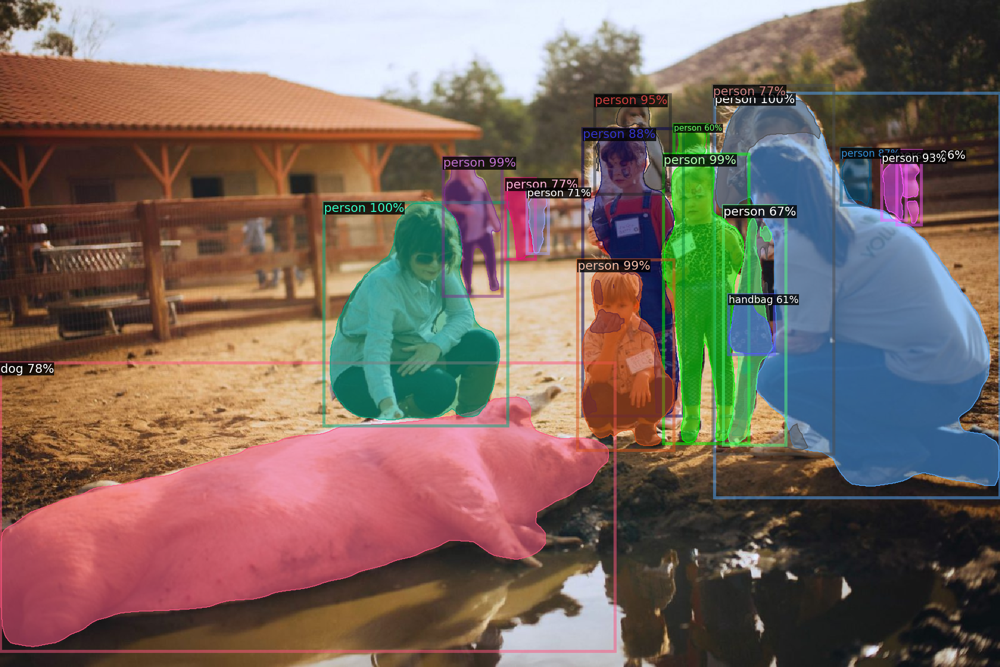

In [ ]:
visualizer = Visualizer(image[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale = 1.2)
out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:,:,::-1])

# **Task 5-2**
**Task 5-2:** Play with image style transfer on your own image set.

## **Tutorial:** https://youtu.be/bFeltWvzZpQ?si=o2BGXkm9YtHEK-rG

In [ ]:
import tensorflow_hub as hub
import tensorflow as tf
from matplotlib import pyplot as plt
import numpy as np
import cv2
import os

# Load the style transfer model
model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

# Define function to load an image
def load_image(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = img[tf.newaxis, :]
    return img

# Function to perform style transfer
def style_transfer(content_image, style_image):
    stylised_image = model(tf.constant(content_image), tf.constant(style_image))[0]
    return stylised_image

# Path to the directory containing content images
content_folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Path to the directory containing style images
style_folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Style Images/"

# Get a list of all content and style image files
content_image_files = [f for f in os.listdir(content_folder_path) if os.path.isfile(os.path.join(content_folder_path, f))]
style_image_files = [f for f in os.listdir(style_folder_path) if os.path.isfile(os.path.join(style_folder_path, f))]

# Process each combination of content and style images
for content_image_file in content_image_files:
    content_image_path = os.path.join(content_folder_path, content_image_file)
    content_image = load_image(content_image_path)

    for style_image_file in style_image_files:
        style_image_path = os.path.join(style_folder_path, style_image_file)
        style_image = load_image(style_image_path)

        # Perform style transfer
        stylised_image = style_transfer(content_image, style_image)

        # Display the stylised image
        plt.imshow(np.squeeze(stylised_image))
        plt.title(f"Content: {content_image_file}, Style: {style_image_file}")
        plt.show()

### **Step by step try for one image at a time**

In [ ]:
import tensorflow_hub as hub
import tensorflow as tf
from matplotlib import pyplot as plt
import numpy as np
import cv2

In [ ]:
model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

In [ ]:
def load_image(img_path):
  img = tf.io.read_file(img_path)
  img = tf.image.decode_image(img, channels = 3)
  img = tf.image.convert_image_dtype(img, tf.float32)
  img = img[tf.newaxis, :]
  return img

In [ ]:
content_image = load_image("/content/IMG_2792.png")
style_image = load_image("/content/IMG_9092.jpeg")

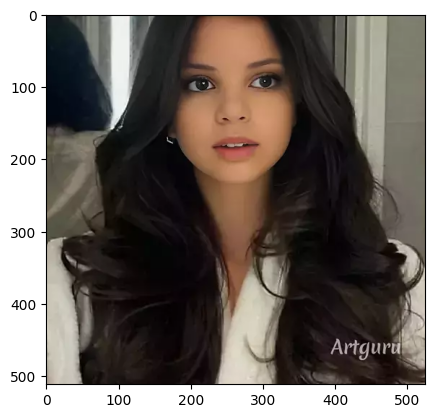

In [ ]:
plt.imshow(np.squeeze(content_image))
plt.show()

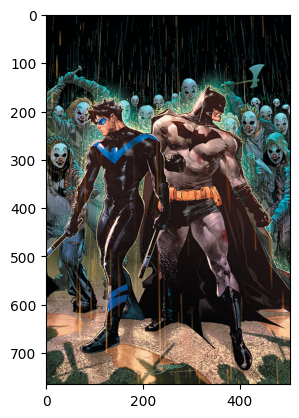

In [ ]:
plt.imshow(np.squeeze(style_image))
plt.show()

In [ ]:
stylised_image = model(tf.constant(content_image), tf.constant(style_image))[0]

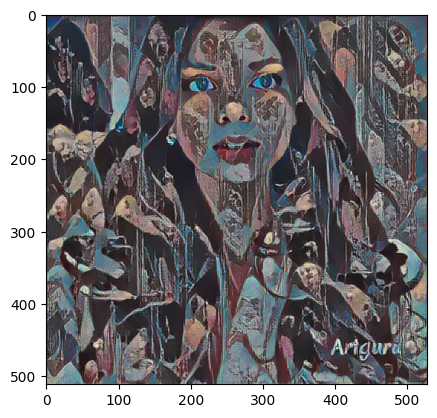

In [ ]:
plt.imshow(np.squeeze(stylised_image))
plt.show()

In [ ]:
style_image2 = load_image("/content/IMG_9105.jpeg")

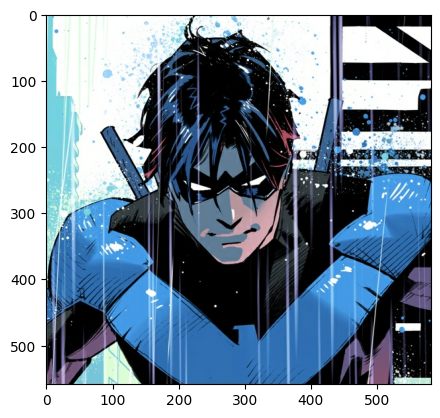

In [ ]:
plt.imshow(np.squeeze(style_image2))
plt.show()

In [ ]:
stylized_image2 = model(tf.constant(content_image), tf.constant(style_image2))

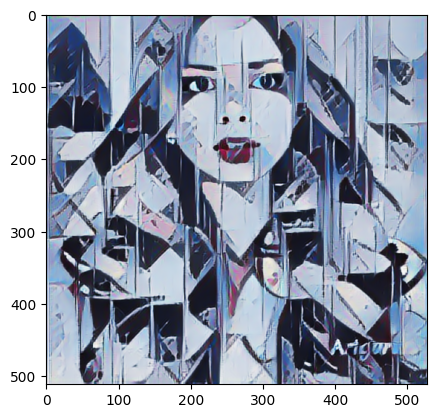

In [ ]:
plt.imshow(np.squeeze(stylized_image2))
plt.show()

In [ ]:
style_image3 = load_image("/content/IMG_9106.jpg.png")

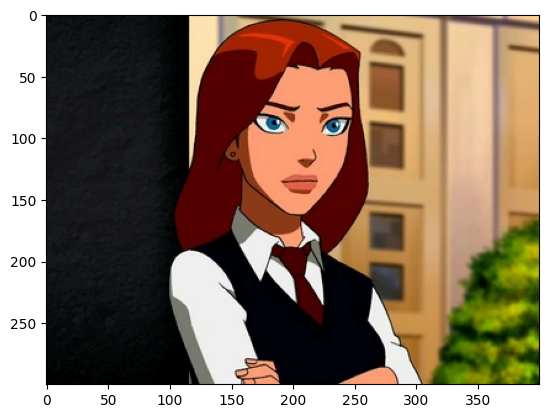

In [ ]:
plt.imshow(np.squeeze(style_image3))
plt.show()

In [ ]:
stylised_image3 = model(tf.constant(content_image), tf.constant(style_image3))

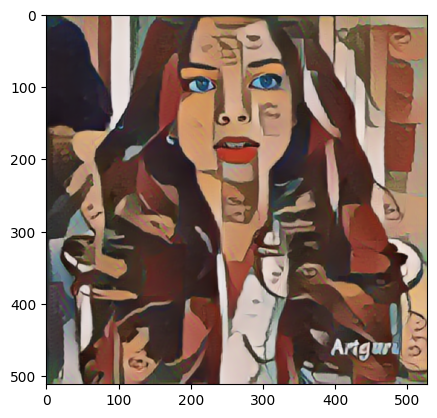

In [ ]:
plt.imshow(np.squeeze(stylised_image3))
plt.show()

## **DRAFT**

In [ ]:
# Mount Google Drive to access files if needed
from google.colab import drive
drive.mount('/content/drive')

# Install torch and other dependencies
!pip install torch torchvision

# Clone the repository
!git clone https://github.com/jcjohnson/neural-style.git

# Navigate to the neural-style directory
%cd neural-style

# Download the pre-trained models
!sh models/download_models.sh

# Install additional dependencies if needed
# For CUDA backend
!pip install torch.cuda
# For cuDNN backend
!pip install cudnn
# For OpenCL backend
!pip install cltorch clnn

# Usage example
!th neural_style.lua -style_image examples/inputs/picasso_selfport1907.jpg -content_image examples/inputs/brad_pitt.jpg -output_image profile.png -model_file models/nin_imagenet_conv.caffemodel -proto_file models/train_val.prototxt -gpu 0 -backend clnn -num_iterations 1000 -seed 123 -content_layers relu0,relu3,relu7,relu12 -style_layers relu0,relu3,relu7,relu12 -content_weight 10 -style_weight 1000 -image_size 512 -optimizer adam

Mounted at /content/drive
Cloning into 'neural-style'...
remote: Enumerating objects: 579, done.
remote: Total 579 (delta 0), reused 0 (delta 0), pack-reused 579
Receiving objects: 100% (579/579), 47.06 MiB | 34.55 MiB/s, done.
Resolving deltas: 100% (269/269), done.
/content/neural-style
--2024-03-06 12:32:36--  https://gist.githubusercontent.com/ksimonyan/3785162f95cd2d5fee77/raw/bb2b4fe0a9bb0669211cf3d0bc949dfdda173e9e/VGG_ILSVRC_19_layers_deploy.prototxt
Resolving gist.githubusercontent.com (gist.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to gist.githubusercontent.com (gist.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5499 (5.4K) [text/plain]
Saving to: ‘VGG_ILSVRC_19_layers_deploy.prototxt’

VGG_ILSVRC_19_layer 100%[===================>]   5.37K  --.-KB/s    in 0s      

2024-03-06 12:32:36 (49.2 MB/s) - ‘VGG_ILSVRC_19_layers_deploy.prototxt’ saved [5499/5499]

--20

In [ ]:
th neural_style.lua -style_image <image.jpg> -content_image <image.jpg>

SyntaxError: invalid syntax (<ipython-input-2-20474c5fb062>, line 1)

In [ ]:
!th neural_style.lua -style_image /content/IMG_9092.jpeg
-content_image /content/IMG_2792.png
-output_image /content/profile.png
-model_file /models/nin_imagenet_conv.caffemodel
-proto_file /models/train_val.prototxt -gpu 0
-backend clnn -num_iterations 1000 -seed 123
-content_layers relu0,relu3,relu7,relu12
-style_layers relu0,relu3,relu7,relu12
-content_weight 10
-style_weight 1000
-image_size 512
-optimizer adam

SyntaxError: invalid syntax (<ipython-input-10-778be5bb3d05>, line 5)

# **ЧЕРНОВИК**

## **MaskRCNN**

### **Packages Downloading**

In [ ]:
!pip install pycocotools
!pip install pixellib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 430.3/430.3 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 31.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 5.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 55.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 338.1/338.1 kB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

### **Segmentation**

In [ ]:
import pixellib
from pixellib.instance import instance_segmentation

segment_image = instance_segmentation()
segment_image.load_model("/content/mask_rcnn_coco.h5")
segment_image.segmentImage("/content/IMG_9092.jpeg", output_image_name = "output_image_path")

OSError: Unable to open file (truncated file: eof = 4194304, sblock->base_addr = 0, stored_eof = 257557808)

## **FastSAM**

### **Downloading Model**

In [ ]:
!git clone https://github.com/CASIA-IVA-Lab/FastSAM.git

fatal: destination path 'FastSAM' already exists and is not an empty directory.


In [ ]:
!wget https://huggingface.co/spaces/An-619/FastSAM/resolve/main/weights/FastSAM.pt

--2024-03-05 15:02:53--  https://huggingface.co/spaces/An-619/FastSAM/resolve/main/weights/FastSAM.pt
Resolving huggingface.co (huggingface.co)... 18.164.174.23, 18.164.174.17, 18.164.174.118, ...
Connecting to huggingface.co (huggingface.co)|18.164.174.23|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/71/c3/71c3ec5a83f3fc374665cec9240f614262e29088fca1a18732571e13c7084f1b/c0be4e7ddbe4c15333d15a859c676d053c486d0a746a3be6a7a9790d52a9b6d7?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27FastSAM.pt%3B+filename%3D%22FastSAM.pt%22%3B&Expires=1709910173&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcwOTkxMDE3M319LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy5odWdnaW5nZmFjZS5jby9yZXBvcy83MS9jMy83MWMzZWM1YTgzZjNmYzM3NDY2NWNlYzkyNDBmNjE0MjYyZTI5MDg4ZmNhMWExODczMjU3MWUxM2M3MDg0ZjFiL2MwYmU0ZTdkZGJlNGMxNTMzM2QxNWE4NTljNjc2ZDA1M2M0ODZkMGE3NDZhM2JlNmE3YTk3OTBkNTJhOWI2ZDc%7EcmVzcG9u

In [ ]:
!pip install -r FastSAM/requirements.txt
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-n8u5addb
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-n8u5addb
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Using cached ftfy-6.1.3-py3-none-any.whl (53 kB)
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=3517b6d799294ee1048cfe9f43fbeb8167425d2d5be40ea0ec2eed9e9f210b39
  Stored in directory: /tmp/pip-ephem-wheel-cache-bs2r7u4i/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


### **Instance Segmentation**

In [ ]:
import matplotlib.pyplot as plt
import cv2

In [ ]:
image = cv2.imread('/content/IMG_9092.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

504 765


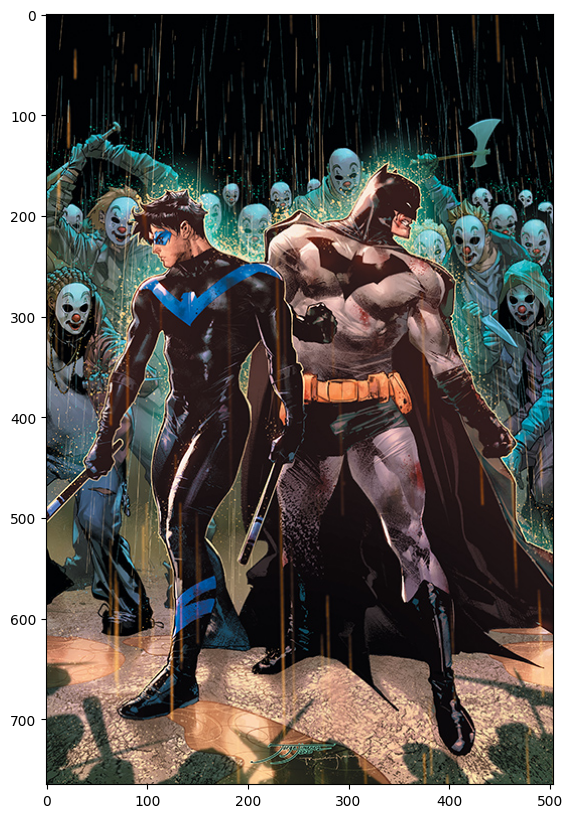

In [ ]:
original_h = image.shape[0]
original_w = image.shape[1]
print(original_w, original_h)
plt.figure(figsize=(10, 10))
plt.imshow(image)

In [ ]:
!python FastSAM/Inference.py  --model_path FastSAM.pt --img_path ./IMG_9092.jpeg --imgsz 1024

2024-03-05 15:04:46.526817: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-05 15:04:46.526909: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-05 15:04:46.530108: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

0: 1024x704 41 objects, 18137.7ms
Speed: 18.4ms preprocess, 18137.7ms inference, 699.3ms postprocess per image at shape (1, 3, 1024, 1024)


504 765


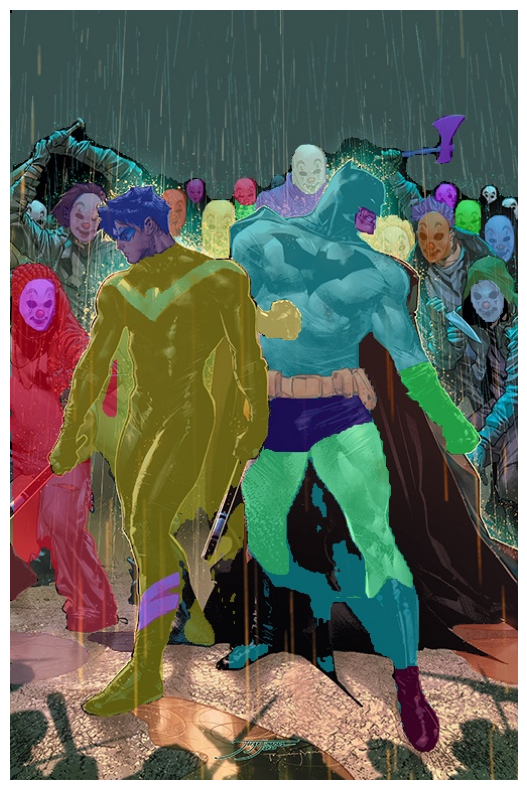

In [ ]:
image = cv2.imread('/content/output/IMG_9092.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
original_h = image.shape[0]
original_w = image.shape[1]
print(original_w, original_h)
plt.figure(figsize=(10, 10))
plt.axis("off")
plt.imshow(image)